# Video Game Sales 

The video game industry has experienced exponential growth over the past few decades, becoming a multi-billion dollar industry that spans the globe. As the popularity of video games continues to soar, the demand for in-depth analysis of video game sales data has become increasingly important. In this report, we will explore the global video game sales data from 1980 to 2020, using various analytical techniques to identify trends and patterns in the industry. The goal is to provide insights into the market dynamics that have shaped the industry, including the impact of technological advancements, changing consumer preferences, and global economic trends. By examining the data, we hope to provide a comprehensive understanding of the video game industry and offer insights that can inform strategic decisions for video game developers, publishers, and retailers.

In [1]:
# Import Relevant Libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
import plotly.express as px
%matplotlib inline

In [2]:
video_games = pd.read_csv('video_games_sales.csv')

In [3]:
# Sales columns are measured in millions of copies sold
video_games.head()

,rank,name,platform,year,genre,publisher,na_sales,eu_sales,jp_sales,other_sales,global_sales
0,1,Wii Sports,Wii,2006.0,Sports,Nintendo,41.49,29.02,3.77,8.46,82.74
1,2,Super Mario Bros.,NES,1985.0,Platform,Nintendo,29.08,3.58,6.81,0.77,40.24
2,3,Mario Kart Wii,Wii,2008.0,Racing,Nintendo,15.85,12.88,3.79,3.31,35.82
3,4,Wii Sports Resort,Wii,2009.0,Sports,Nintendo,15.75,11.01,3.28,2.96,33.00
4,5,Pokemon Red/Pokemon Blue,GB,1996.0,Role-Playing,Nintendo,11.27,8.89,10.22,1.00,31.37


In [4]:
video_games.shape

(16598, 11)

In [5]:
video_games.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16598 entries, 0 to 16597
Data columns (total 11 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   rank          16598 non-null  int64  
 1   name          16598 non-null  object 
 2   platform      16598 non-null  object 
 3   year          16327 non-null  float64
 4   genre         16598 non-null  object 
 5   publisher     16540 non-null  object 
 6   na_sales      16598 non-null  float64
 7   eu_sales      16598 non-null  float64
 8   jp_sales      16598 non-null  float64
 9   other_sales   16598 non-null  float64
 10  global_sales  16598 non-null  float64
dtypes: float64(6), int64(1), object(4)
memory usage: 1.4+ MB


In [6]:
video_games.describe()

,rank,year,na_sales,eu_sales,jp_sales,other_sales,global_sales
count,16598.000000,16327.000000,16598.000000,16598.000000,16598.000000,16598.000000,16598.000000
mean,8300.605254,2006.406443,0.264667,0.146652,0.077782,0.048063,0.537441
std,4791.853933,5.828981,0.816683,0.505351,0.309291,0.188588,1.555028
min,1.000000,1980.000000,0.000000,0.000000,0.000000,0.000000,0.010000
25%,4151.250000,2003.000000,0.000000,0.000000,0.000000,0.000000,0.060000
50%,8300.500000,2007.000000,0.080000,0.020000,0.000000,0.010000,0.170000
75%,12449.750000,2010.000000,0.240000,0.110000,0.040000,0.040000,0.470000
max,16600.000000,2020.000000,41.490000,29.020000,10.220000,10.570000,82.740000


<AxesSubplot:>

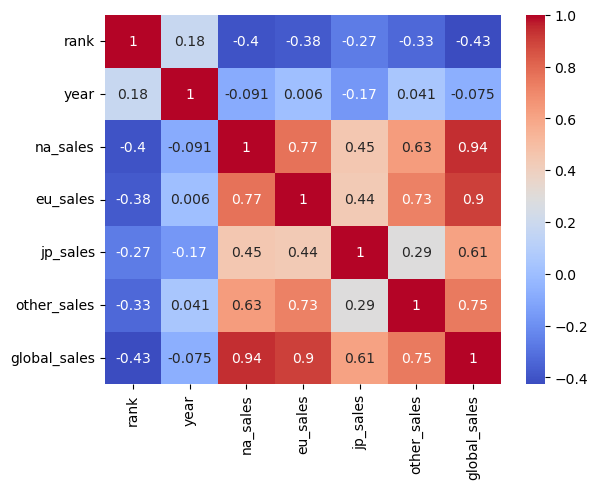

In [7]:
sns.heatmap(data=video_games.corr(),annot=True,cmap='coolwarm')

In [8]:
video_games.columns

Index(['rank', 'name', 'platform', 'year', 'genre', 'publisher', 'na_sales',
       'eu_sales', 'jp_sales', 'other_sales', 'global_sales'],
      dtype='object')

In [9]:
# Checking for null values
video_games.isna().sum()

rank              0
name              0
platform          0
year            271
genre             0
publisher        58
na_sales          0
eu_sales          0
jp_sales          0
other_sales       0
global_sales      0
dtype: int64

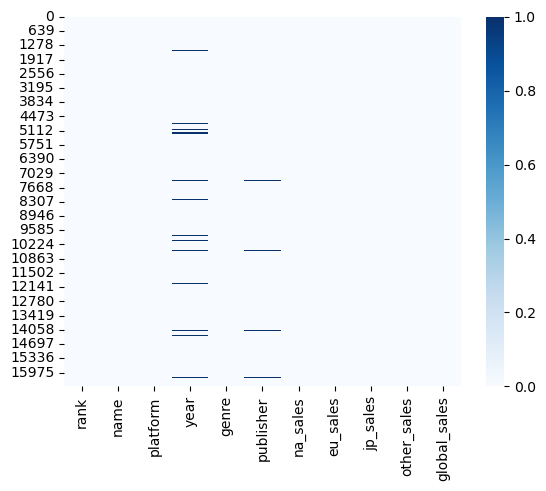

In [10]:
sns.heatmap(data=video_games.isna(),cmap='Blues')
plt.show()

In [11]:
# Converting 'year' column to datetime format from float64
video_games['year'] = pd.to_datetime(video_games['year'], format='%Y')

# EDA

Let's check out the array of genres, platforms and other columns in the dataset. We will also analyze which year, game, genre and platform has the most copies sold in terms of global sales.

In [12]:
sns.set_style('whitegrid')
sns.set_palette('rainbow')

In [13]:
video_games['genre'].unique()

array(['Sports', 'Platform', 'Racing', 'Role-Playing', 'Puzzle', 'Misc',
       'Shooter', 'Simulation', 'Action', 'Fighting', 'Adventure',
       'Strategy'], dtype=object)

In [14]:
video_games['platform'].unique()

array(['Wii', 'NES', 'GB', 'DS', 'X360', 'PS3', 'PS2', 'SNES', 'GBA',
       '3DS', 'PS4', 'N64', 'PS', 'XB', 'PC', '2600', 'PSP', 'XOne', 'GC',
       'WiiU', 'GEN', 'DC', 'PSV', 'SAT', 'SCD', 'WS', 'NG', 'TG16',
       '3DO', 'GG', 'PCFX'], dtype=object)

In [15]:
# Number of publishers in this dataset
video_games['publisher'].nunique()

578

In [16]:
video_games['year'].value_counts()

2009-01-01    1431
2008-01-01    1428
2010-01-01    1259
2007-01-01    1202
2011-01-01    1139
2006-01-01    1008
2005-01-01     941
2002-01-01     829
2003-01-01     775
2004-01-01     763
2012-01-01     657
2015-01-01     614
2014-01-01     582
2013-01-01     546
2001-01-01     482
1998-01-01     379
2000-01-01     349
2016-01-01     344
1999-01-01     338
1997-01-01     289
1996-01-01     263
1995-01-01     219
1994-01-01     121
1993-01-01      60
1981-01-01      46
1992-01-01      43
1991-01-01      41
1982-01-01      36
1986-01-01      21
1989-01-01      17
1983-01-01      17
1990-01-01      16
1987-01-01      16
1988-01-01      15
1985-01-01      14
1984-01-01      14
1980-01-01       9
2017-01-01       3
2020-01-01       1
Name: year, dtype: int64

It seems like most of the video games in the dataset were released in 2009, and seeing that there are only 4 games released after 2016, we will omit these 4 rows from the data frame.

In [17]:
# There are only 4 games released after 2016 in this dataset. We will omit this data from now on.
games_after_2016 = video_games[(video_games['year'] == '2017-01-01') | (video_games['year'] == '2020-01-01')]

In [18]:
# Only 4 games released after 2016
games_after_2016.head()

,rank,name,platform,year,genre,publisher,na_sales,eu_sales,jp_sales,other_sales,global_sales
5957,5959,Imagine: Makeup Artist,DS,2020-01-01,Simulation,Ubisoft,0.27,0.0,0.00,0.02,0.29
14390,14393,Phantasy Star Online 2 Episode 4: Deluxe Package,PS4,2017-01-01,Role-Playing,Sega,0.00,0.0,0.03,0.00,0.03
16241,16244,Phantasy Star Online 2 Episode 4: Deluxe Package,PSV,2017-01-01,Role-Playing,Sega,0.00,0.0,0.01,0.00,0.01
16438,16441,Brothers Conflict: Precious Baby,PSV,2017-01-01,Action,Idea Factory,0.00,0.0,0.01,0.00,0.01


Digital console sales started to gain significant traction in the video game industry around 2010-2012. The Xbox 360 and PlayStation 3 consoles introduced digital marketplaces such as Xbox Live Marketplace and PlayStation Store, respectively, which allowed users to download and purchase digital versions of games and additional content. Since then, digital sales have continued to grow and have become an increasingly important part of the video game industry, with many new games now releasing simultaneously in both physical and digital formats.

As we can see above in the table, there are only 4 games recorded that are released between 2017 and 2020 in this dataset, which doesn't make sense because there are many new releases in that period as well, maybe this dataset doesn't record digital sales ever since Xbox Live Marketplace and PlayStation Store took off around 2012. Hence, there is a probability that digital sales over console and PC are not included in this dataset.

In [19]:
# Let's exclude these video games from above
video_games2 = video_games[(video_games['year'] != '2017-01-01') & (video_games['year'] != '2020-01-01')]

In [20]:
# Double Check if rows still exist in updated Data Frame
video_games2[(video_games2['year']=='2017-01-01')]

,rank,name,platform,year,genre,publisher,na_sales,eu_sales,jp_sales,other_sales,global_sales


In [21]:
fig0 = go.Figure(data=[go.Pie(labels=video_games2['genre'],values=video_games2['global_sales'],textinfo='label+percent',
                             insidetextorientation='radial',hole=0.3)])
fig0.update_layout(title='Global Video Game Sales by Genre')
fig0.show()

In [22]:
# Top 10 games with most copies sold
top10_games = video_games2.head(10)
top10_games

,rank,name,platform,year,genre,publisher,na_sales,eu_sales,jp_sales,other_sales,global_sales
0,1,Wii Sports,Wii,2006-01-01,Sports,Nintendo,41.49,29.02,3.77,8.46,82.74
1,2,Super Mario Bros.,NES,1985-01-01,Platform,Nintendo,29.08,3.58,6.81,0.77,40.24
2,3,Mario Kart Wii,Wii,2008-01-01,Racing,Nintendo,15.85,12.88,3.79,3.31,35.82
3,4,Wii Sports Resort,Wii,2009-01-01,Sports,Nintendo,15.75,11.01,3.28,2.96,33.00
4,5,Pokemon Red/Pokemon Blue,GB,1996-01-01,Role-Playing,Nintendo,11.27,8.89,10.22,1.00,31.37
5,6,Tetris,GB,1989-01-01,Puzzle,Nintendo,23.20,2.26,4.22,0.58,30.26
6,7,New Super Mario Bros.,DS,2006-01-01,Platform,Nintendo,11.38,9.23,6.50,2.90,30.01
7,8,Wii Play,Wii,2006-01-01,Misc,Nintendo,14.03,9.20,2.93,2.85,29.02
8,9,New Super Mario Bros. Wii,Wii,2009-01-01,Platform,Nintendo,14.59,7.06,4.70,2.26,28.62
9,10,Duck Hunt,NES,1984-01-01,Shooter,Nintendo,26.93,0.63,0.28,0.47,28.31


Text(0, 0.5, 'Millions of copies sold')

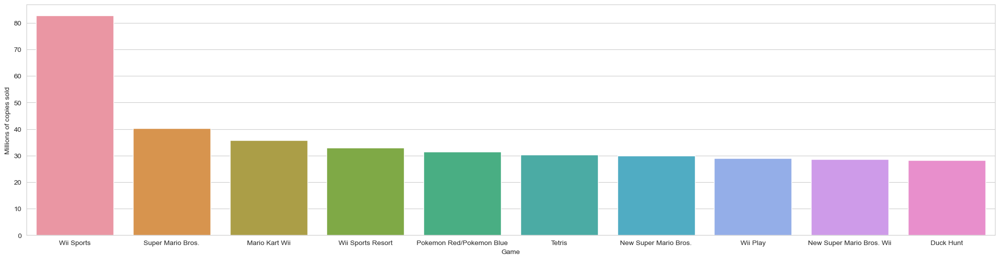

In [23]:
plt.figure(figsize=(25,6))
sns.barplot(data=top10_games,x='name',y='global_sales')
plt.xlabel('Game')
plt.ylabel('Millions of copies sold')

The top 10 games that sold the most copies are Nintendo games. Wii Sports is the top selling game of all time with more than 80 million copies sold. 

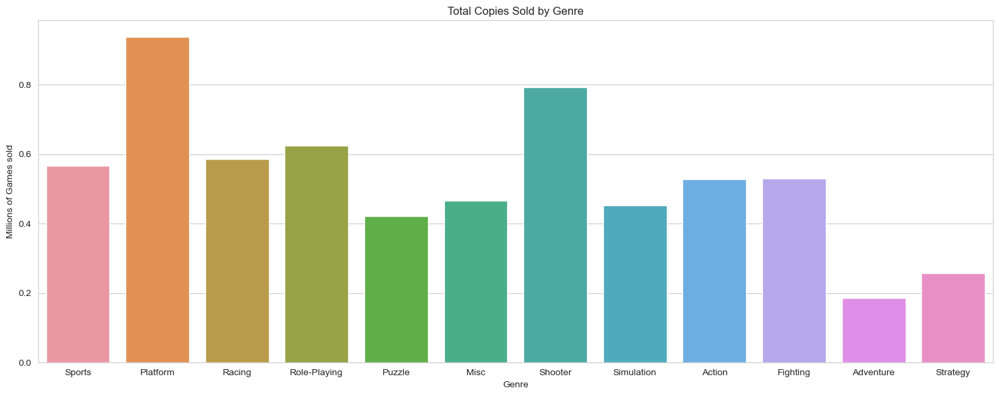

In [24]:
plt.figure(figsize=(15,6))
sns.barplot(data=video_games2,x='genre',y='global_sales',ci=False)
plt.xlabel('Genre')
plt.ylabel('Millions of Games sold')
plt.title('Total Copies Sold by Genre')
plt.tight_layout()

The popular genre by global sales is the platform genre (Example: Super Mario Bros (Rank 2) and New Super Mario Bros (Rank 7).)

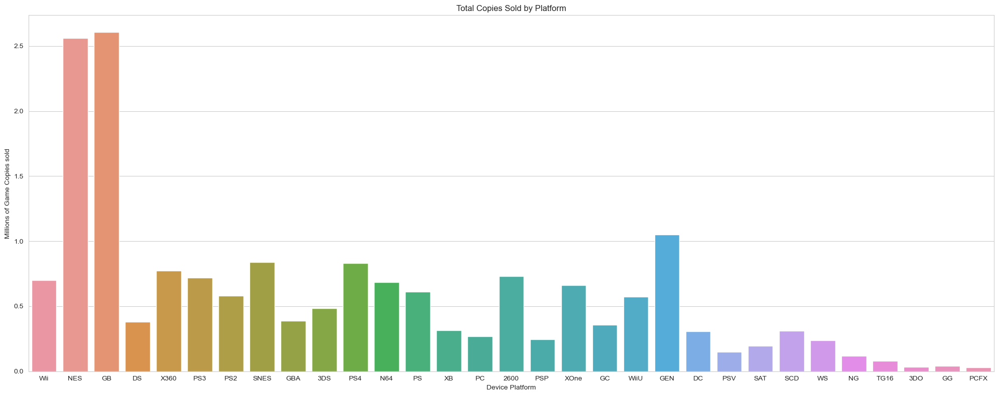

In [25]:
plt.figure(figsize=(20,8))
sns.barplot(data=video_games2,x='platform',y='global_sales',ci=False)
plt.xlabel('Device Platform')
plt.ylabel('Millions of Game Copies sold')
plt.title('Total Copies Sold by Platform')
plt.tight_layout()

The most popular platform by global sales is the GB(Gameboy) with its' most popular game being Pokemon Red/Blue (Rank 5).

# Manipulating Data for Deeper Analysis

In [26]:
video_games2['platform'].unique()

array(['Wii', 'NES', 'GB', 'DS', 'X360', 'PS3', 'PS2', 'SNES', 'GBA',
       '3DS', 'PS4', 'N64', 'PS', 'XB', 'PC', '2600', 'PSP', 'XOne', 'GC',
       'WiiU', 'GEN', 'DC', 'PSV', 'SAT', 'SCD', 'WS', 'NG', 'TG16',
       '3DO', 'GG', 'PCFX'], dtype=object)

In [27]:
# Creating a function to determine the manufacturer of the different platforms

def get_manufacturer(platform):
    if platform in ['Wii','NES','GB','DS','SNES','GBA','3DS','N64','GC','WiiU']:
        return 'Nintendo'
    elif platform in ['X360', 'XOne', 'XB']:
        return 'Microsoft'
    elif platform in ['PS', 'PS2', 'PS3', 'PS4', 'PSP', 'PSV']:
        return 'Sony'
    elif platform in ['2600']:
        return 'Atari'
    elif platform in ['GEN','DC','SAT','SCD','GG']:
        return 'Sega'
    elif platform in ['WS']:
        return 'Bandai'
    elif platform in ['NG']:
        return 'SNK'
    elif platform in ['TG16','PCFX']:
        return 'NEC'
    elif platform in ['3DO']:
        return 'Panasonic'
    elif platform in ['PC']:
        return 'PC'

    else:
        return 'Other'

In [28]:
# Creating a 'manufacturer' column
video_games2['manufacturer'] = video_games2['platform'].apply(get_manufacturer)

C:\Users\JakeKZY\AppData\Local\Temp\ipykernel_8644\129607551.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [29]:
video_games2['manufacturer'].unique()

array(['Nintendo', 'Microsoft', 'Sony', 'PC', 'Atari', 'Sega', 'Bandai',
       'SNK', 'NEC', 'Panasonic'], dtype=object)

In [30]:
# Creating variables for each platform for further analysis

Nintendo_platform = video_games2[video_games2['manufacturer']=='Nintendo']

Microsoft_platform = video_games2[video_games2['manufacturer']=='Microsoft']

Sony_platform = video_games2[video_games2['manufacturer']=='Sony']

Atari_platform = video_games2[video_games2['manufacturer']=='Atari']

Sega_platform = video_games2[video_games2['manufacturer']=='Sega']

Bandai_platform = video_games2[video_games2['manufacturer']=='Bandai']

SNK_platform = video_games2[video_games2['manufacturer']=='SNK']

NEC_platform = video_games2[video_games2['manufacturer']=='NEC']

Panasonic_platform = video_games2[video_games2['manufacturer']=='Panasonic']

PC_platform = video_games2[video_games2['manufacturer']=='PC']

In [31]:
Nintendo_platform.head(10)

,rank,name,platform,year,genre,publisher,na_sales,eu_sales,jp_sales,other_sales,global_sales,manufacturer
0,1,Wii Sports,Wii,2006-01-01,Sports,Nintendo,41.49,29.02,3.77,8.46,82.74,Nintendo
1,2,Super Mario Bros.,NES,1985-01-01,Platform,Nintendo,29.08,3.58,6.81,0.77,40.24,Nintendo
2,3,Mario Kart Wii,Wii,2008-01-01,Racing,Nintendo,15.85,12.88,3.79,3.31,35.82,Nintendo
3,4,Wii Sports Resort,Wii,2009-01-01,Sports,Nintendo,15.75,11.01,3.28,2.96,33.00,Nintendo
4,5,Pokemon Red/Pokemon Blue,GB,1996-01-01,Role-Playing,Nintendo,11.27,8.89,10.22,1.00,31.37,Nintendo
5,6,Tetris,GB,1989-01-01,Puzzle,Nintendo,23.20,2.26,4.22,0.58,30.26,Nintendo
6,7,New Super Mario Bros.,DS,2006-01-01,Platform,Nintendo,11.38,9.23,6.50,2.90,30.01,Nintendo
7,8,Wii Play,Wii,2006-01-01,Misc,Nintendo,14.03,9.20,2.93,2.85,29.02,Nintendo
8,9,New Super Mario Bros. Wii,Wii,2009-01-01,Platform,Nintendo,14.59,7.06,4.70,2.26,28.62,Nintendo
9,10,Duck Hunt,NES,1984-01-01,Shooter,Nintendo,26.93,0.63,0.28,0.47,28.31,Nintendo


# Grouping Data

In [32]:
# Grouping data by platform with their individual global sales

platform_by_global_sales = video_games2.groupby('platform').sum()['global_sales'].reset_index()
platform_by_global_sales.sort_values(by='global_sales',ascending=False,inplace=True)
platform_by_global_sales

,platform,global_sales
16,PS2,1255.64
28,X360,979.96
17,PS3,957.84
26,Wii,926.71
4,DS,822.20
15,PS,730.66
6,GBA,318.50
19,PSP,296.28
18,PS4,278.07
13,PC,258.82


In [33]:
# Grouping data by name, genre and publisher with their individual global sales

name_genre_publisher_by_global_sales = video_games2.groupby(['name','genre','publisher']).sum()['global_sales'].reset_index()
name_genre_publisher_by_global_sales.sort_values(by='global_sales',ascending=False,inplace=True)
name_genre_publisher_by_global_sales

,name,genre,publisher,global_sales
11363,Wii Sports,Sports,Nintendo,82.74
3825,Grand Theft Auto V,Action,Take-Two Interactive,55.92
9635,Super Mario Bros.,Platform,Nintendo,45.31
10036,Tetris,Puzzle,Nintendo,35.84
5738,Mario Kart Wii,Racing,Nintendo,35.82
...,...,...,...,...
9770,Sweet Honey Coming,Adventure,Kadokawa Shoten,0.01
8327,Root Double: Before Crime After Days,Action,Yeti,0.01
8330,Rosario to Vampire: Tanabata no Miss Youkai Ga...,Adventure,Capcom,0.01
2752,E.T. The Extra-Terrestrial,Action,NewKidCo,0.01


In [34]:
# Grouping data by manufacturer with their individual global sales

manufacturer_by_global_sales = video_games2.groupby('manufacturer').sum()['global_sales'].reset_index()
manufacturer_by_global_sales.sort_values(by='global_sales',ascending=False,inplace=True)
manufacturer_by_global_sales

,manufacturer,global_sales
9,Sony,3580.40
4,Nintendo,3521.54
2,Microsoft,1379.28
5,PC,258.82
0,Atari,97.08
8,Sega,79.83
7,SNK,1.44
1,Bandai,1.42
3,NEC,0.19
6,Panasonic,0.10


In [35]:
# Grouping data by genre with global sales sold that year

genre_by_global_sales = video_games2.groupby('genre').sum()['global_sales'].reset_index()
genre_by_global_sales.sort_values(by='global_sales',ascending=False,inplace=True)
genre_by_global_sales

,genre,global_sales
0,Action,1751.17
10,Sports,1330.93
8,Shooter,1037.37
7,Role-Playing,927.33
4,Platform,831.37
3,Misc,809.96
6,Racing,732.04
2,Fighting,448.91
9,Simulation,391.91
5,Puzzle,244.95


In [36]:
# Grouping data by year with global sales for copies sold that year

year_by_global_sales = video_games2.groupby('year').sum()['global_sales'].reset_index()
year_by_global_sales.sort_values(by='global_sales',ascending=False,inplace=True)
year_by_global_sales

# In this current dataset, there is not much data on video games sold from 2016 onwards.
# Hence, we shall analyze the older games that are released before 2016 and exclude games released after 2016.

,year,global_sales
28,2008-01-01,678.90
29,2009-01-01,667.30
27,2007-01-01,611.13
30,2010-01-01,600.45
26,2006-01-01,521.04
31,2011-01-01,515.99
25,2005-01-01,459.94
24,2004-01-01,419.31
22,2002-01-01,395.52
33,2013-01-01,368.11


# Sales by Platform and Manufacturer Analysis

Text(0.5, 1.0, 'Global Sales of Video Games by Manufacturer')

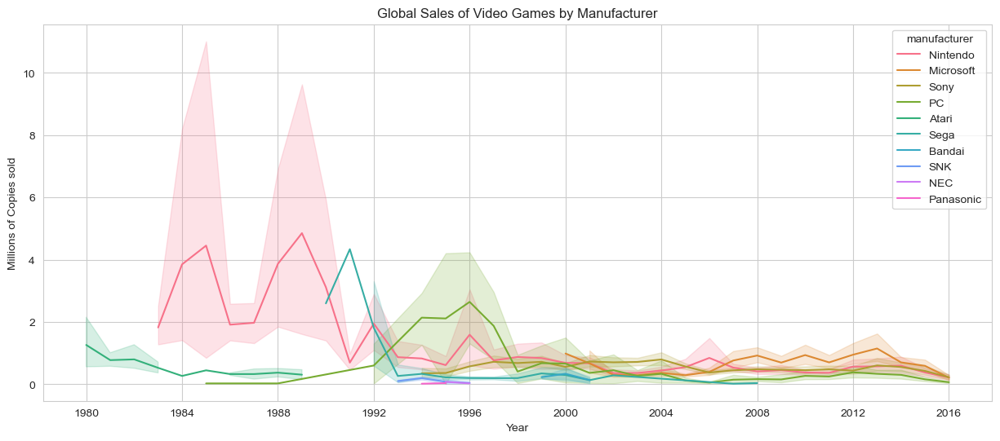

In [37]:
plt.figure(figsize=(15,6))
sns.lineplot(x='year',y='global_sales',data=video_games2,hue='manufacturer')
plt.xlabel('Year')
plt.ylabel('Millions of Copies sold')
plt.title('Global Sales of Video Games by Manufacturer')

Text(0.5, 1.0, 'Number of Titles for Each Platform')

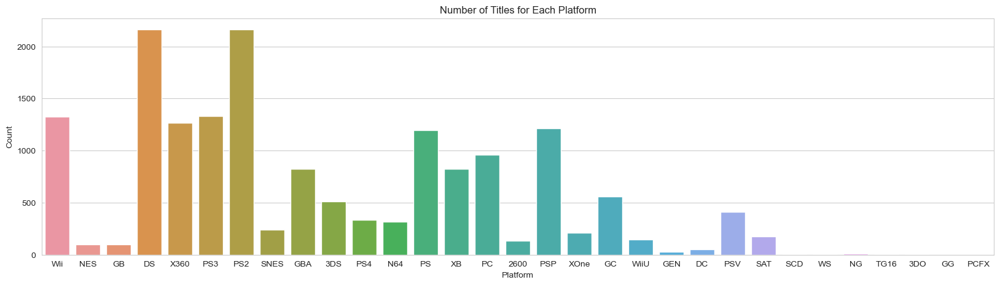

In [38]:
plt.figure(figsize=(20,5))
sns.countplot(x='platform',data=video_games2)
plt.xlabel('Platform')
plt.ylabel('Count')
plt.title('Number of Titles for Each Platform')

Text(0.5, 1.0, 'Titles Released for Each Manufacturer')

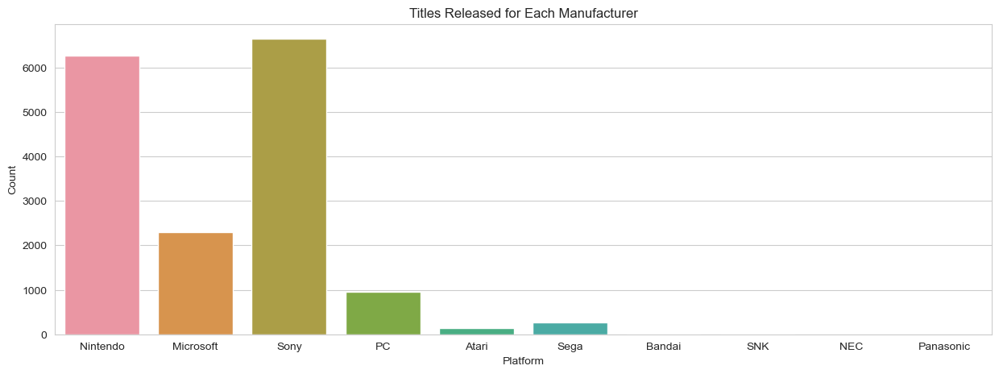

In [39]:
# Visualizing the number of Game Titles released on each platform's manufacturer
plt.figure(figsize=(15,5))
sns.countplot(x='manufacturer',data=video_games2)
plt.xlabel('Platform')
plt.ylabel('Count')
plt.title('Titles Released for Each Manufacturer')

Sony appears to have the most number of game titles under their successful Playstations with more than 6000 games released for all of their platforms. Nintendo trails behind at 2nd place also with more than 6000 games released for all of their platforms. 

In [40]:
fig1 = go.Figure(data=[go.Pie(labels=manufacturer_by_global_sales['manufacturer'],values=video_games2['global_sales'],textinfo='label+percent',
                             insidetextorientation='radial',hole=0.3)])
fig1.update_layout(title='Global Video Game Sales by Manufacturer')
fig1.show()

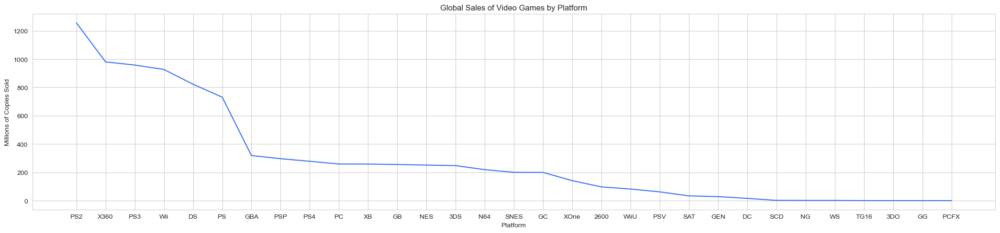

In [41]:
plt.figure(figsize=(21,5))
sns.lineplot(data=platform_by_global_sales,x='platform',y='global_sales')
plt.xlabel('Platform')
plt.ylabel('Millions of Copies Sold')
plt.title('Global Sales of Video Games by Platform')
plt.tight_layout()

In [42]:
# Let's first check the top 10 platforms by global sales of video games on that platform.

top10_platforms = platform_by_global_sales.head(10)
top10_platforms

,platform,global_sales
16,PS2,1255.64
28,X360,979.96
17,PS3,957.84
26,Wii,926.71
4,DS,822.20
15,PS,730.66
6,GBA,318.50
19,PSP,296.28
18,PS4,278.07
13,PC,258.82


Text(0.5, 1.0, 'Top 10 Platforms by Global Sales')

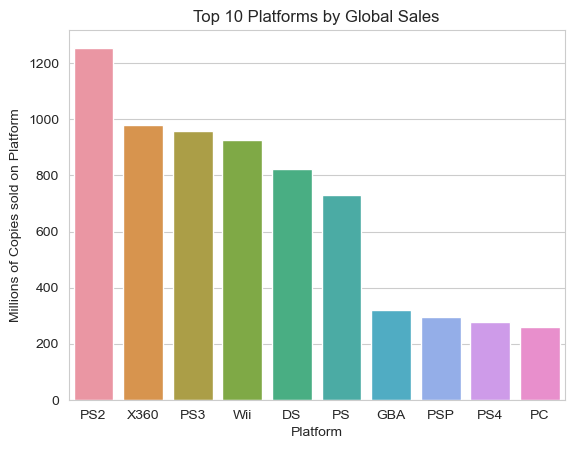

In [43]:
sns.barplot(data=top10_platforms,x='platform',y='global_sales')
plt.xlabel('Platform')
plt.ylabel('Millions of Copies sold on Platform')
plt.title('Top 10 Platforms by Global Sales')

The Playstation 2 leads with the most copies sold at 1200 million copies, the Xbox 360 trails behind with less than 1000 million copies sold. Overall, Sony and Nintendo dominate the top 10 platforms (except for PC at num 10) in terms of total copies sold on all each of their platforms. 

In [44]:
# Let's choose the top 4 consoles with the most global sales between them.

ps2_games = video_games2[(video_games2['platform']=='PS2')]
# Top 5 PS2 games
top5_ps2_games = ps2_games.head(5)

x360_games = video_games2[(video_games2['platform']=='X360')]
# Top 5 Xbox 360 games
top5_x360_games = x360_games.head(5)

ps3_games = video_games2[(video_games2['platform']=='PS3')]
# Top 5 PS3 games
top5_ps3_games = ps3_games.head(5)

wii_games = video_games2[(video_games2['platform']=='Wii')]
# Top 5 Nintendo Wii games
top5_wii_games = wii_games.head(5)

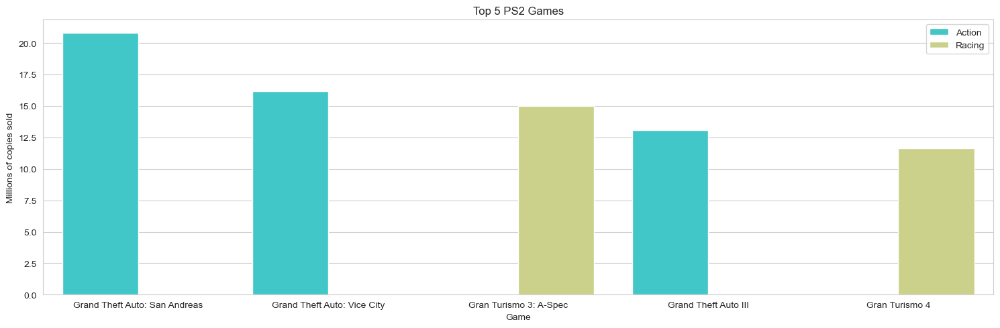

In [45]:
plt.figure(figsize=(15,5))
sns.barplot(data=top5_ps2_games,x='name',y='global_sales',hue='genre',palette='rainbow')
plt.xlabel('Game')
plt.ylabel('Millions of copies sold')
plt.title('Top 5 PS2 Games')
plt.legend(loc=0)
plt.tight_layout()

The Grand Theft Auto and Gran Turismo series of games dominate the PS2 generation as the top 5 most sold games during that time.

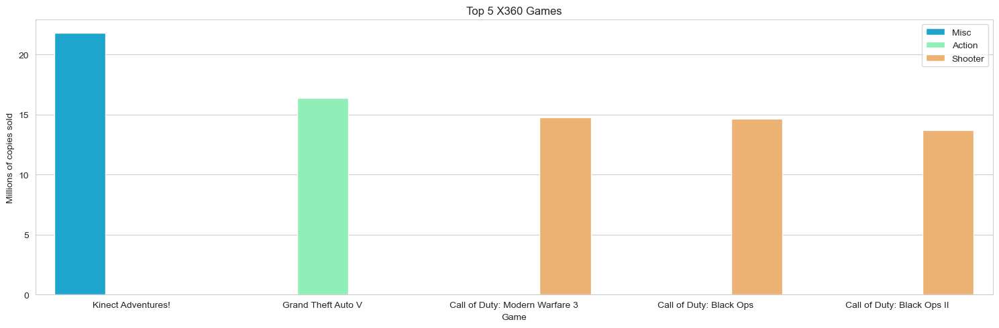

In [46]:
plt.figure(figsize=(15,5))
sns.barplot(data=top5_x360_games,x='name',y='global_sales',hue='genre',palette='rainbow')
plt.xlabel('Game')
plt.ylabel('Millions of copies sold')
plt.title('Top 5 X360 Games')
plt.legend(loc=0)
plt.tight_layout()

Kinect Adventures! is a sports video game released by Microsoft Game Studios for the Xbox 360. It topped the sales for video games sold for this platform, while GTA V from Take Two Interactive comes in at 2nd place, and next 3 are dominated by Activision's Call of Duty series.

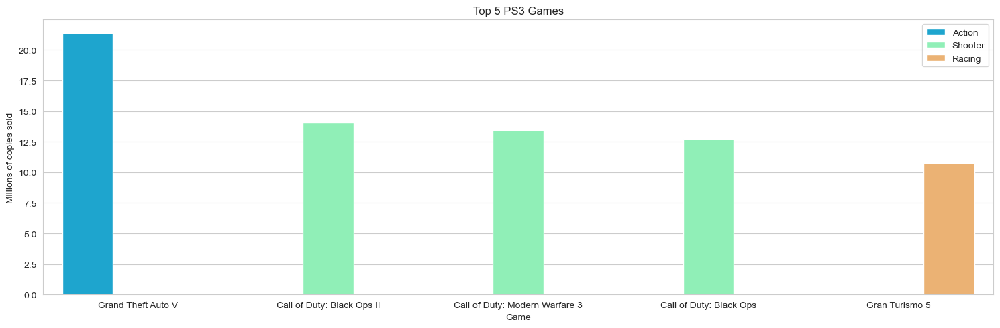

In [47]:
plt.figure(figsize=(15,5))
sns.barplot(data=top5_ps3_games,x='name',y='global_sales',hue='genre',palette='rainbow')
plt.xlabel('Game')
plt.ylabel('Millions of copies sold')
plt.title('Top 5 PS3 Games')
plt.legend(loc=0)
plt.tight_layout()

It is almost the same for the PS3 console with GTA V taking the top spot for this platform, while Activision's Call of Duty series hold the 2nd to 4th spot, and lastly Sony's Gran Turismo 5 takes the 5th spot on the chart as the most copies sold for this platform.

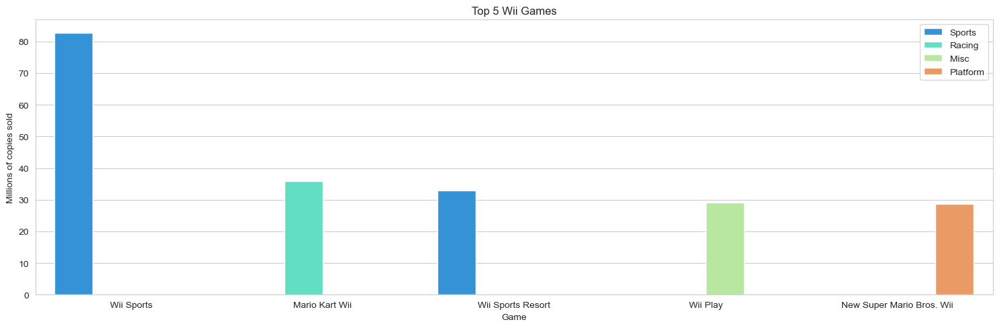

In [48]:
plt.figure(figsize=(15,5))
sns.barplot(data=top5_wii_games,x='name',y='global_sales',hue='genre',palette='rainbow')
plt.xlabel('Game')
plt.ylabel('Millions of copies sold')
plt.title('Top 5 Wii Games')
plt.legend(loc=1)
plt.tight_layout()

The Nintendo Wii platform top 5 selling games are published by Nintendo themselves, with Wii Sports taking the top spot with more than 80 million copies sold, this is because Wii Sports was one of the launch titles for the Nintendo Wii console, which was released in 2006. The game was bundled with the console, meaning that it was included in every purchase of the Wii, and it quickly became a cultural phenomenon. 

# Sales by Region Analysis

In [49]:
# Since the sales values of different regions are in different columns.
# Let's break down the different regions into different variables with their own tables.

NA_sales = video_games2[['rank','name','platform','year','genre','publisher','na_sales','manufacturer']]
NA_sales_sorted = NA_sales.sort_values(by='na_sales',ascending=False)

EU_sales = video_games2[['rank','name','platform','year','genre','publisher','eu_sales','manufacturer']]
EU_sales_sorted = EU_sales.sort_values(by='eu_sales',ascending=False)

JP_sales = video_games2[['rank','name','platform','year','genre','publisher','jp_sales','manufacturer']]
JP_sales_sorted = JP_sales.sort_values(by='jp_sales',ascending=False)

Other_sales = video_games2[['rank','name','platform','year','genre','publisher','other_sales','manufacturer']]
Other_sales_sorted = Other_sales.sort_values(by='other_sales',ascending=False)

In [50]:
# Top 10 Games in North America
top10_NA_games = NA_sales_sorted.head(10)
top10_NA_games

,rank,name,platform,year,genre,publisher,na_sales,manufacturer
0,1,Wii Sports,Wii,2006-01-01,Sports,Nintendo,41.49,Nintendo
1,2,Super Mario Bros.,NES,1985-01-01,Platform,Nintendo,29.08,Nintendo
9,10,Duck Hunt,NES,1984-01-01,Shooter,Nintendo,26.93,Nintendo
5,6,Tetris,GB,1989-01-01,Puzzle,Nintendo,23.20,Nintendo
2,3,Mario Kart Wii,Wii,2008-01-01,Racing,Nintendo,15.85,Nintendo
3,4,Wii Sports Resort,Wii,2009-01-01,Sports,Nintendo,15.75,Nintendo
15,16,Kinect Adventures!,X360,2010-01-01,Misc,Microsoft Game Studios,14.97,Microsoft
8,9,New Super Mario Bros. Wii,Wii,2009-01-01,Platform,Nintendo,14.59,Nintendo
7,8,Wii Play,Wii,2006-01-01,Misc,Nintendo,14.03,Nintendo
18,19,Super Mario World,SNES,1990-01-01,Platform,Nintendo,12.78,Nintendo


Text(0.5, 1.0, 'Number of Titles sold on Platform')

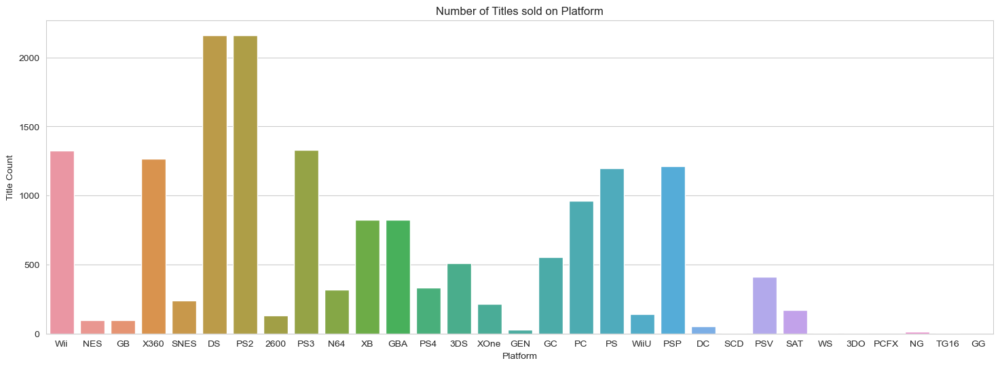

In [51]:
plt.figure(figsize=(18,6))
sns.countplot(x='platform',data=NA_sales_sorted)
plt.xlabel('Platform')
plt.ylabel('Title Count')
plt.title('Number of Titles sold on Platform')

In [52]:
fig_NA = px.bar(NA_sales_sorted, 
             y="platform", 
             x="na_sales", 
             color="genre", 
             orientation="h",
             width=800,
             height=600,
             hover_data=['rank','name','year'],
             labels={'na_sales':'Millions of Copies Sold', 'platform':'Platform'})
fig_NA.show()

In the North American region, the Xbox 360 is the leading platform for game consoles. The cumulative amount of video game copies sold has passed 600 million by 2016 according to this dataset. The leading genre for the Xbox 360 is the shooter genre with Activision's Call of Duty: Black Ops selling 9.67 million copies for that title.

In [53]:
# Top 10 Games in Europe
top10_EU_games = EU_sales_sorted.head(10)
top10_EU_games

,rank,name,platform,year,genre,publisher,eu_sales,manufacturer
0,1,Wii Sports,Wii,2006-01-01,Sports,Nintendo,29.02,Nintendo
2,3,Mario Kart Wii,Wii,2008-01-01,Racing,Nintendo,12.88,Nintendo
3,4,Wii Sports Resort,Wii,2009-01-01,Sports,Nintendo,11.01,Nintendo
10,11,Nintendogs,DS,2005-01-01,Simulation,Nintendo,11.00,Nintendo
16,17,Grand Theft Auto V,PS3,2013-01-01,Action,Take-Two Interactive,9.27,Sony
19,20,Brain Age: Train Your Brain in Minutes a Day,DS,2005-01-01,Misc,Nintendo,9.26,Nintendo
6,7,New Super Mario Bros.,DS,2006-01-01,Platform,Nintendo,9.23,Nintendo
7,8,Wii Play,Wii,2006-01-01,Misc,Nintendo,9.20,Nintendo
4,5,Pokemon Red/Pokemon Blue,GB,1996-01-01,Role-Playing,Nintendo,8.89,Nintendo
14,15,Wii Fit Plus,Wii,2009-01-01,Sports,Nintendo,8.59,Nintendo


Text(0.5, 1.0, 'Number of Titles sold on Platform')

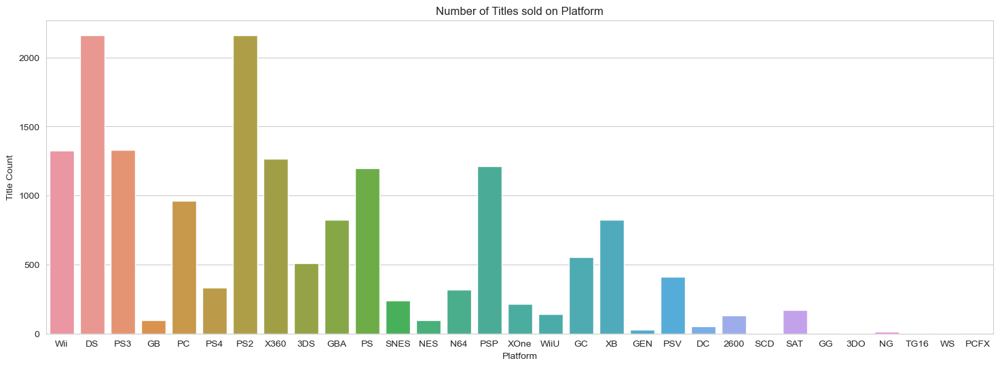

In [54]:
plt.figure(figsize=(18,6))
sns.countplot(x='platform',data=EU_sales_sorted,)
plt.xlabel('Platform')
plt.ylabel('Title Count')
plt.title('Number of Titles sold on Platform')

In [55]:
fig_EU = px.bar(EU_sales_sorted, 
             y="platform", 
             x="eu_sales", 
             color="genre", 
             orientation="h",
             width=800,
             height=600,
             hover_data=['rank','name','year'],
             labels={'eu_sales':'Millions of Copies Sold', 'platform':'Platform'})
fig_EU.show()

In the European region, the Playstation 2 and 3 are the most widely used consoles with both of them having more than 300 million of game copies sold in each of their platforms. The top games in these two consoles are Take Two Interactive's Grand Theft Auto V (PS3) and Grand Theft Auto Vice City (PS2). Grand Theft Auto V is a very popular open world action game that is still being played on the latest console, and it is easily one of Take Two Interactive's most sold game and its' prized cash cow. 

In [56]:
# Top 10 Games in Japan
top10_JP_games = JP_sales_sorted.head(10)
top10_JP_games

,rank,name,platform,year,genre,publisher,jp_sales,manufacturer
4,5,Pokemon Red/Pokemon Blue,GB,1996-01-01,Role-Playing,Nintendo,10.22,Nintendo
12,13,Pokemon Gold/Pokemon Silver,GB,1999-01-01,Role-Playing,Nintendo,7.20,Nintendo
1,2,Super Mario Bros.,NES,1985-01-01,Platform,Nintendo,6.81,Nintendo
6,7,New Super Mario Bros.,DS,2006-01-01,Platform,Nintendo,6.50,Nintendo
20,21,Pokemon Diamond/Pokemon Pearl,DS,2006-01-01,Role-Playing,Nintendo,6.04,Nintendo
26,27,Pokemon Black/Pokemon White,DS,2010-01-01,Role-Playing,Nintendo,5.65,Nintendo
25,26,Pokemon Ruby/Pokemon Sapphire,GBA,2002-01-01,Role-Playing,Nintendo,5.38,Nintendo
41,42,Animal Crossing: Wild World,DS,2005-01-01,Simulation,Nintendo,5.33,Nintendo
27,28,Brain Age 2: More Training in Minutes a Day,DS,2005-01-01,Puzzle,Nintendo,5.32,Nintendo
214,215,Monster Hunter Freedom 3,PSP,2010-01-01,Role-Playing,Capcom,4.87,Sony


Text(0.5, 1.0, 'Number of Titles sold on Platform')

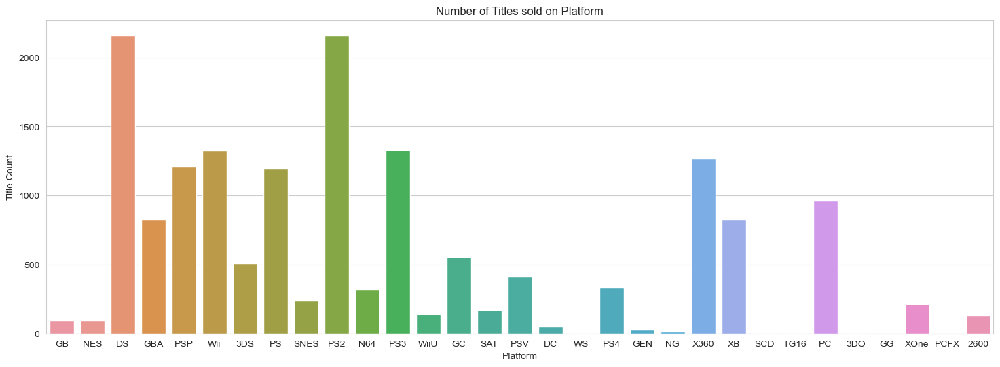

In [57]:
plt.figure(figsize=(18,6))
sns.countplot(x='platform',data=JP_sales_sorted,)
plt.xlabel('Platform')
plt.ylabel('Title Count')
plt.title('Number of Titles sold on Platform')

In [58]:
fig_JP = px.bar(JP_sales_sorted, 
             y="platform", 
             x="jp_sales", 
             color="genre", 
             orientation="h",
             width=800,
             height=600,
             hover_data=['rank','name','year'],
             labels={'jp_sales':'Millions of Copies Sold', 'platform':'Platform'}
             )
fig_JP.show()

In Japan, the Nintendo DS is the most dominant platform in the country with their own game "New Super Mario Bros." being the most popular game with 6.5 million copies sold since 2006. However, Pokemon Red/Blue remains the number 1 most sold game in Japan with more than 10.2 million copies sold since 1996. The Gameboy was very popular at the time because of its' portability, and it became a cultural icon.

Although the Nintendo DS stands at the top of the charts, however the 2nd and 3rd place goes to the Playstation (PS) and Playstation 2 (PS2). The Dragon Quests series of games stands out as the country top-selling games for these consoles with Dragon Quest VII and VIII selling 4.1 million and 3.61 million copies respectively.

In [59]:
# Top 10 Games in Other Regions
top10_Other_games = Other_sales_sorted.head(10)
top10_Other_games

,rank,name,platform,year,genre,publisher,other_sales,manufacturer
17,18,Grand Theft Auto: San Andreas,PS2,2004-01-01,Action,Take-Two Interactive,10.57,Sony
0,1,Wii Sports,Wii,2006-01-01,Sports,Nintendo,8.46,Nintendo
47,48,Gran Turismo 4,PS2,2004-01-01,Racing,Sony Computer Entertainment,7.53,Sony
16,17,Grand Theft Auto V,PS3,2013-01-01,Action,Take-Two Interactive,4.14,Sony
2,3,Mario Kart Wii,Wii,2008-01-01,Racing,Nintendo,3.31,Nintendo
3,4,Wii Sports Resort,Wii,2009-01-01,Sports,Nintendo,2.96,Nintendo
348,349,Pro Evolution Soccer 2008,PS2,2007-01-01,Sports,Konami Digital Entertainment,2.93,Sony
6,7,New Super Mario Bros.,DS,2006-01-01,Platform,Nintendo,2.90,Nintendo
7,8,Wii Play,Wii,2006-01-01,Misc,Nintendo,2.85,Nintendo
10,11,Nintendogs,DS,2005-01-01,Simulation,Nintendo,2.75,Nintendo


Text(0.5, 1.0, 'Number of Titles sold on Platform')

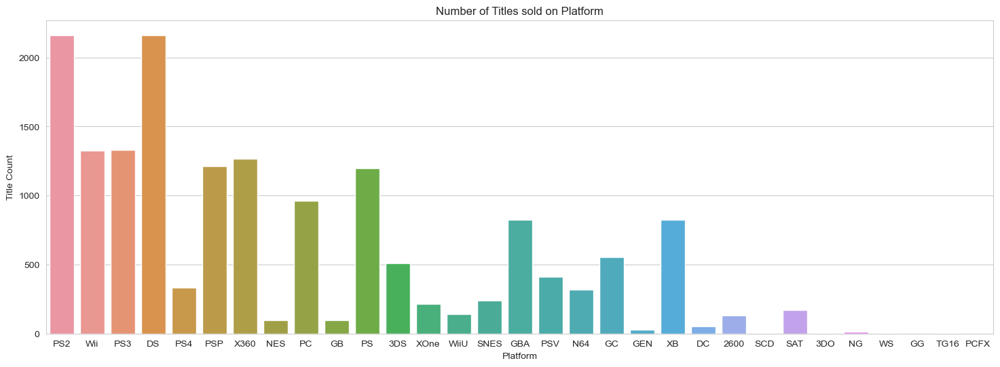

In [60]:
plt.figure(figsize=(18,6))
sns.countplot(x='platform',data=Other_sales_sorted,)
plt.xlabel('Platform')
plt.ylabel('Title Count')
plt.title('Number of Titles sold on Platform')

In [61]:
fig_Other = px.bar(Other_sales_sorted, 
             y="platform", 
             x="other_sales", 
             color="genre", 
             orientation="h",
             width=800,
             height=600,
             hover_data=['rank','name','year'],
             labels={'other_sales':'Millions of Copies Sold', 'platform':'Platform'})
fig_Other.show()

In other regions of the world, the Playstation 2 is the most popular and dominant console with Grand Theft Auto: San Andreas having the most copies sold at 10.57 million copies since its' release in 2004. The PlayStation 2 (PS2) is the most sold console out of all the PlayStation consoles. As of March 31, 2012, Sony had sold over 155 million units of the PlayStation 2, making it the best-selling video game console of all time, this would reflect its' popularity around and the sheer number of titles sold for this platform. 

# Sales by Genre Analysis

In [62]:
# Ranking Genres by Global Sales
genre_by_global_sales

,genre,global_sales
0,Action,1751.17
10,Sports,1330.93
8,Shooter,1037.37
7,Role-Playing,927.33
4,Platform,831.37
3,Misc,809.96
6,Racing,732.04
2,Fighting,448.91
9,Simulation,391.91
5,Puzzle,244.95


Text(0.5, 1.0, 'Number of Games by Genre')

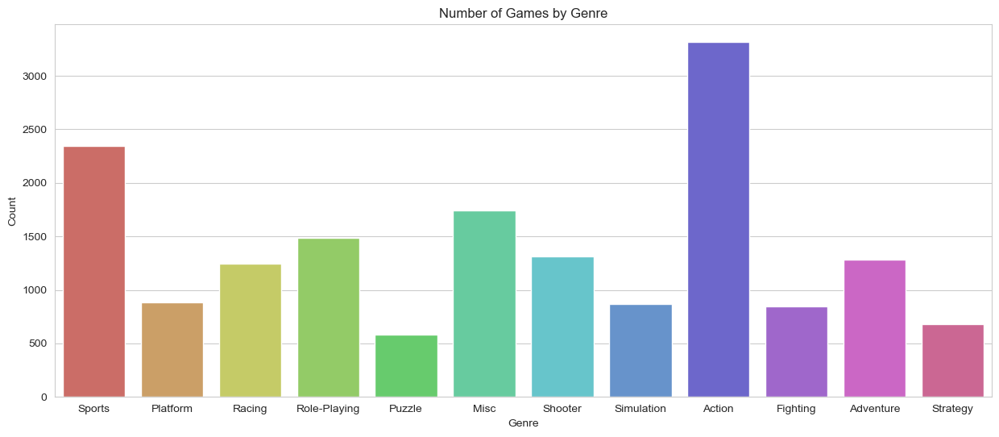

In [63]:
plt.figure(figsize=(15,6))
sns.countplot(x='genre',data=video_games2,palette='hls')
plt.xlabel('Genre')
plt.ylabel('Count')
plt.title('Number of Games by Genre')

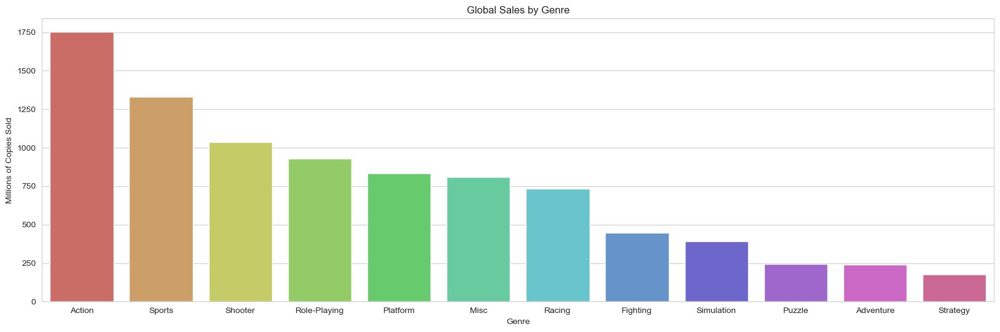

In [64]:
plt.figure(figsize=(20,6))
sns.barplot(x='genre',y='global_sales',data=genre_by_global_sales,palette='hls')
plt.title("Global Sales by Genre")
plt.xlabel("Genre")
plt.ylabel("Millions of Copies Sold")
plt.show()

Overall, the action genre seems to be the most popular game genre globally, with more than 3000 title releases and 1750 million total copies sold since 1980 to 2016.

In [65]:
fig2 = go.Figure(data=[go.Pie(labels=NA_sales['genre'],values=NA_sales['na_sales'],textinfo='label+percent',
                             insidetextorientation='radial',hole=0.3)])
fig2.update_layout(title='North American Video Game Sales by Genre')
fig2.show()

In [66]:
fig3 = go.Figure(data=[go.Pie(labels=EU_sales['genre'],values=EU_sales['eu_sales'],textinfo='label+percent',
                             insidetextorientation='radial',hole=0.3)])
fig3.update_layout(title='Europe Video Game Sales by Genre')
fig3.show()

In [67]:
fig4 = go.Figure(data=[go.Pie(labels=JP_sales['genre'],values=JP_sales['jp_sales'],textinfo='label+percent',
                             insidetextorientation='radial',hole=0.3)])
fig4.update_layout(title='Japan Video Game Sales by Genre')
fig4.show()

In [68]:
fig5 = go.Figure(data=[go.Pie(labels=Other_sales['genre'],values=Other_sales['other_sales'],textinfo='label+percent',
                             insidetextorientation='radial',hole=0.3)])
fig5.update_layout(title='Other Region Video Game Sales by Genre')
fig5.show()

As shown in the 4 donut charts above, the action genre can take up 20% or more of each of the charts except Japan, which the role-playing game genre that takes up more than a quarter of all the games sold in Japan. 

# Sales by Publisher Analysis

There are more than 578 game publsihers in this dataset, so we're going to group them by their total copies sold gloablly. Then, we're going to check out the top 10 to get an insight of their sales and create a barplot for clarity. Finally, since there are too many publishers to fit inside a bar chart, we shall create a treemap to better visualize the data. 

In [69]:
publisher_by_games = video_games2.groupby('publisher').count()['name'].reset_index()
publisher_by_games.sort_values(by='name',ascending=False,inplace=True)
publisher_by_games

,publisher,name
138,Electronic Arts,1351
21,Activision,975
347,Namco Bandai Games,932
525,Ubisoft,920
275,Konami Digital Entertainment,832
...,...,...
403,Playmates,1
404,Playmore,1
405,Plenty,1
406,Pony Canyon,1


In [70]:
top10_producer_of_titles = publisher_by_games.head(10)
top10_producer_of_titles

,publisher,name
138,Electronic Arts,1351
21,Activision,975
347,Namco Bandai Games,932
525,Ubisoft,920
275,Konami Digital Entertainment,832
488,THQ,715
359,Nintendo,703
456,Sony Computer Entertainment,683
446,Sega,637
494,Take-Two Interactive,413


Text(0.5, 1.0, 'Top 10 Publishers by Titles Released')

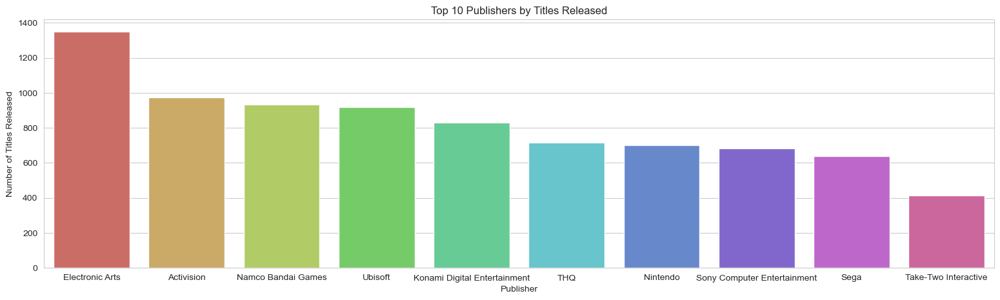

In [71]:
plt.figure(figsize=(19,5))
sns.barplot(x='publisher',y='name',data=top10_producer_of_titles,palette='hls',ci=False)
plt.xlabel('Publisher')
plt.ylabel('Number of Titles Released')
plt.title('Top 10 Publishers by Titles Released')

In [72]:
publisher_by_global_sales = video_games2.groupby('publisher').sum()['global_sales'].reset_index()
publisher_by_global_sales.sort_values(by='global_sales',ascending=False,inplace=True)
publisher_by_global_sales

,publisher,global_sales
359,Nintendo,1786.56
138,Electronic Arts,1110.32
21,Activision,727.46
456,Sony Computer Entertainment,607.50
525,Ubisoft,474.43
...,...,...
375,Ongakukan,0.01
96,Commseed,0.01
495,Takuyo,0.01
76,Boost On,0.01


In [73]:
top10_publishers = publisher_by_global_sales.head(10)
top10_publishers

,publisher,global_sales
359,Nintendo,1786.56
138,Electronic Arts,1110.32
21,Activision,727.46
456,Sony Computer Entertainment,607.50
525,Ubisoft,474.43
494,Take-Two Interactive,399.54
488,THQ,340.77
275,Konami Digital Entertainment,283.64
446,Sega,272.95
347,Namco Bandai Games,254.09


Text(0.5, 1.0, 'Top 10 Publishers by Global Sales')

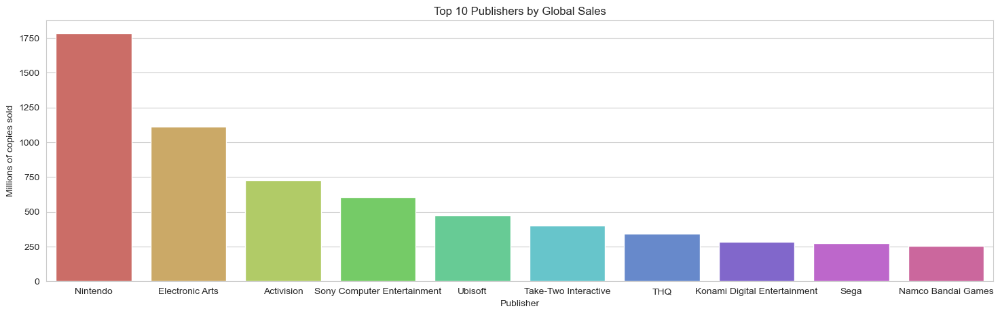

In [74]:
plt.figure(figsize=(18,5))
sns.barplot(x='publisher',y='global_sales',data=top10_publishers,palette='hls',ci=False)
plt.xlabel('Publisher')
plt.ylabel('Millions of copies sold')
plt.title('Top 10 Publishers by Global Sales')

In [75]:
fig_publishertree = px.treemap(name_genre_publisher_by_global_sales, 
                               path=['publisher', 'name'], 
                               values='global_sales',
                               hover_data=['genre'])
fig_publishertree.show()

Clearly, the treemap is showing that Nintendo as a publisher is dominating the sales due to the sales strategy applied by bundling Wii Sports together with each sale of the Nintendo Wii console. Overall, Nintendo's copies sold globally amounts to 1786.56 million game copies. Electronic Arts trails behind in 2nd place in total game copies sold, but it is first in number of titles released under its' label. 

# Sales by Year Analysis

<AxesSubplot:xlabel='year', ylabel='global_sales'>

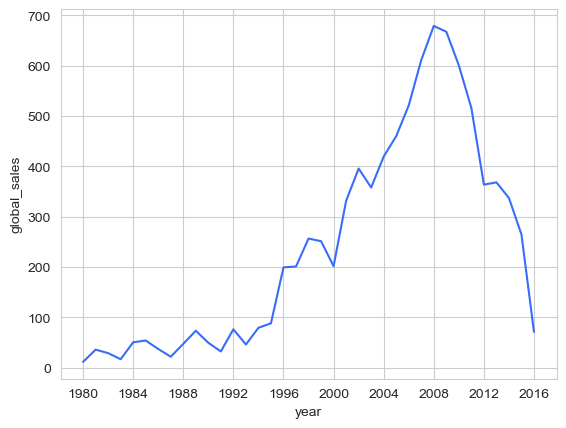

In [76]:
sns.lineplot(x='year',y='global_sales',data=year_by_global_sales)

In [77]:
game_releases_by_year = video_games2.groupby('year').count()['name'].reset_index()
game_releases_by_year.sort_values(by='name',ascending=False,inplace=True)
game_releases_by_year.head()

,year,name
29,2009-01-01,1431
28,2008-01-01,1428
30,2010-01-01,1259
27,2007-01-01,1202
31,2011-01-01,1139


Text(0.5, 1.0, 'Number of Game Releases by Year')

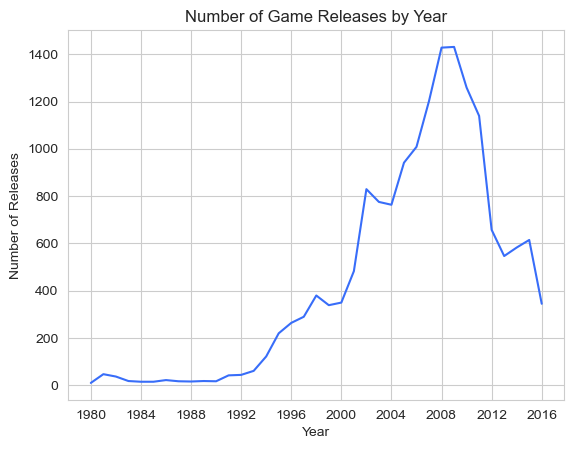

In [78]:
sns.lineplot(x='year',y='name',data=game_releases_by_year)
plt.xlabel('Year')
plt.ylabel('Number of Releases')
plt.title('Number of Game Releases by Year')

In [79]:
fig_year = px.scatter(video_games2, 
                      x="year", 
                      y="global_sales",
                      color='genre', 
                      marginal_x="histogram", 
                      marginal_y="rug",
                      height=750,
                      hover_data=['rank','name','platform']
                     )
fig_year.show()

The growth of video sales has been growing steadily since 1980, it started to explode in the mid 1990s, and by the 2000s it hit total of 200 million game copies sold across the various platforms in our dataset. Video Game Sales growth hit a peak in 2008, and then it started to decline after that. 

This is because the growth of digital sales through online stores for video game consoles started to pick up in the mid to late 2000s with the release of consoles such as the Xbox 360 and PlayStation 3, both of which had online stores where users could purchase and download games directly to their consoles. The trend continued with the release of the Xbox One and PlayStation 4, which have since been succeeded by newer consoles such as the Xbox Series X/S and PlayStation 5 that also heavily rely on digital sales through online stores. 

Hence, there is a possibility that this dataset was only collecting the data of retail/brick and mortar store sales. Which would explain the trend post-2008. 

In Conclusion, Sony and Nintendo are the top dogs in the gaming industry with their consoles dominating the markets all around the world, the PS2 is best selling console of all time and Wii Sports selling the most copies with more than 82 million copies sold around the world. The biggest region for video games in terms of sales is North America due to North Americans deep roots in video game culture and high disposable income among the population. Action video games remains as the best-selling genre globally except Japan which prefers Role-Playing games. Finally, Nintendo remains the king of all publishers with 1786.56 million copies of its' 703 titles, while Electronic Arts has released the most game titles under its' label with 1351 games. 